In [40]:
import pandas as pd
import matplotlib.pyplot as plt 
from wordcloud import WordCloud, STOPWORDS

data = pd.read_csv("/Users/vaasay/Downloads/cleaned_dataset.csv")

data.groupby("verdict").count()


,id,title,text,comment1,comment2,score
verdict,,,,,,
esh,6880,6880,6880,6880,6880,6880
nah,13342,13342,13342,13342,13342,13342
nta,203079,203079,203079,203079,203079,203079
yta,47408,47408,47408,47408,47408,47408


In [41]:
nta_data = data[data["verdict"] == "nta"]
nta_data = nta_data["text"]
nta_data

0         i turned 30 on monday. i don't have a problem ...
1         feed up with my gf. for 6 years ive supported ...
2          so at the start of the school year. like any ...
3         sorry for format, using mobile. so a little bi...
4         so next week is finals week at my university a...
                                ...                        
270703    it's april fools and i was still awake at 2 am...
270704    my great grandma gigi, ran a business back in ...
270705    so my (15f) birthday was a few days ago and my...
270706    i have already posted this story but now i’m p...
270708    for some context, i had a baby in january. cra...
Name: text, Length: 203079, dtype: object

In [42]:
from nltk.corpus import stopwords

stop = set(stopwords.words('english'))

custom_stopwords = set(['said', 'told', 'asked', 'want', 'say', 'going', 'thing', 'think', 'know', 'go', 'got', 'make', 'one', 'made', 'u', 'saying'])  # replace with your own set of words

stopwords = STOPWORDS.union(custom_stopwords,stop)

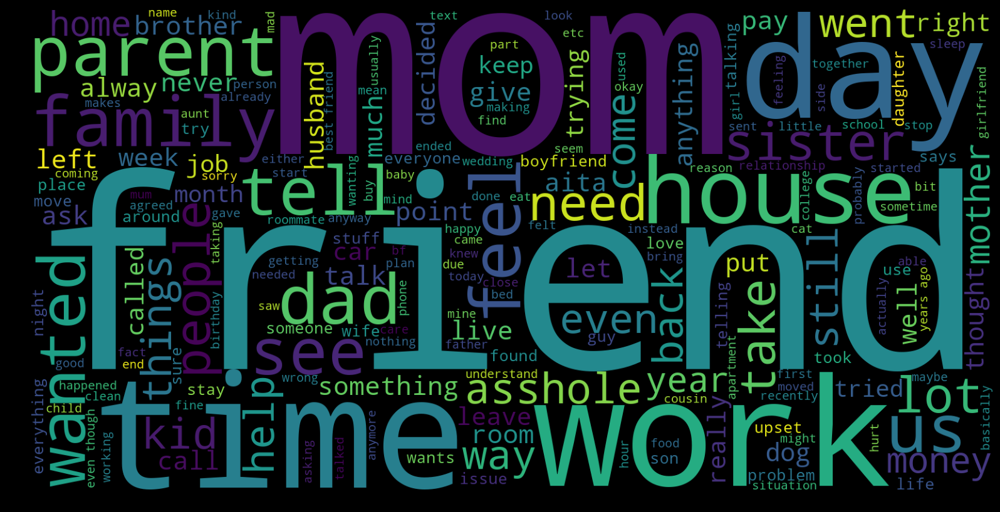

In [43]:


wordcloud = WordCloud(background_color="black",width=1600, height=800, stopwords=stopwords).generate(' '.join(nta_data.tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)

In [44]:
yta_data = data[data["verdict"] == "yta"]
yta_data = yta_data["text"]
yta_data

83        this post is an influence from a recent tragic...
96        my boyfriend and i have a group of friends we ...
116       new semester, new roommate. my roommate tends ...
122       i think that if you think that other people ar...
139       so here’s the thing: my boyfriend and i have b...
                                ...                        
270659    i cant sleep and this is the reason. i (39 m) ...
270666    i'll try to keep this short (please ignore gra...
270670    have been amicably separated a few years. two ...
270688    recently a group of friends and i went on a tr...
270707    character line-up: me (32f), and my girlfriend...
Name: text, Length: 47408, dtype: object

In [45]:
#remove punctuations
yta_data = yta_data.str.replace("[^a-zA-Z#]", " ")
#lowering string
yta_data = yta_data.str.lower()

/var/folders/4t/sm1hd11n4jx39wh5kcx0k9c40000gn/T/ipykernel_94738/3813218092.py:2: FutureWarning: The default value of regex will change from True to False in a future version.
  yta_data = yta_data.str.replace("[^a-zA-Z#]", " ")


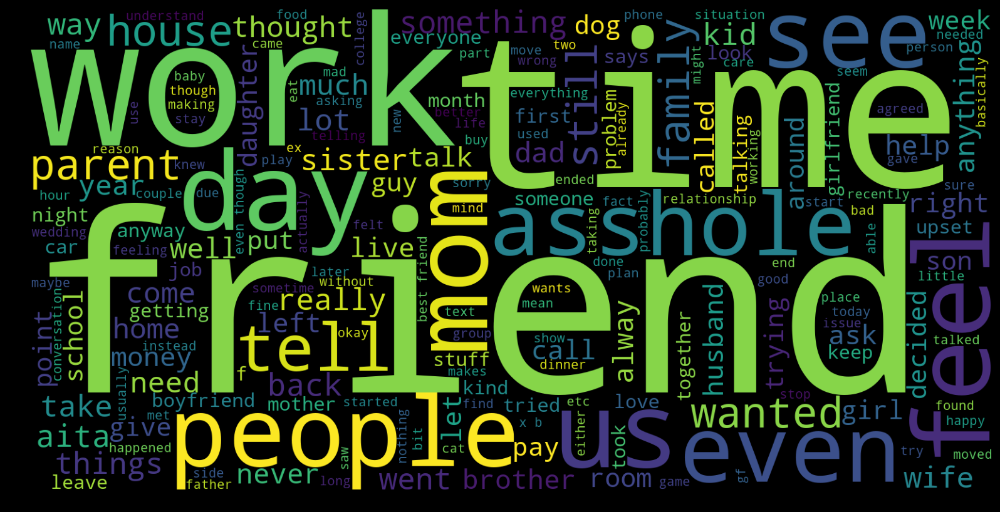

In [46]:
wordcloud = WordCloud(background_color="black",width=1600, height=800, stopwords=stopwords).generate(' '.join(yta_data.tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)

In [47]:
esh_data = data[data["verdict"] == "esh"] 
esh_data = esh_data["text"]
esh_data

1646      **set-up and dynamics** well, it’s been a seme...
1664      in another subreddit, public freakout, there i...
1706      this has happened about 3 years ago in 9th gra...
1731      so, my friend, lets call her kc had a bf, we c...
1742      a friend and i had made plans just under a wee...
                                ...                        
270272    i (19f) decided to go with my mother (36m) and...
270315    to preface, this is a throwaway since my frien...
270634    when covid hit we had just had our newborn bab...
270642    hey reddit today my bf (27m) confessed he's ad...
270699    my brother (21m) and i (14f) keep having the s...
Name: text, Length: 6880, dtype: object

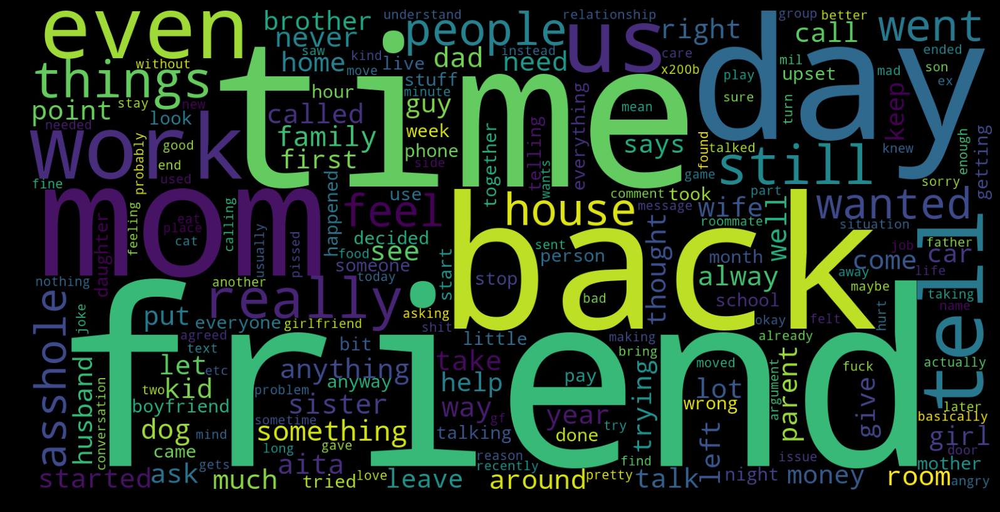

In [48]:
wordcloud = WordCloud(background_color="black",width=1600, height=800, stopwords=stopwords).generate(' '.join(esh_data.tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)

In [49]:
nah_data = data[data["verdict"] == "nah"] 
nah_data = nah_data["text"]
nah_data

1667      i'm annoyed. this morning my (half) sister dra...
1714      so on r/piano i posted a short little piece of...
1717      my stepdad’s biggest pet peeve is when people ...
1730      he's always walking around the house without a...
1764      my 96 year old grandmother was admitted into t...
                                ...                        
270487    a little back story: my wife and i recently we...
270504    longtime lurker here. so as per title, i have ...
270509    my 9yo son cameron spend his spring break on a...
270558    i have a best friend lets call her sam. sam an...
270629    so i (18m) recently got into an argument with ...
Name: text, Length: 13342, dtype: object

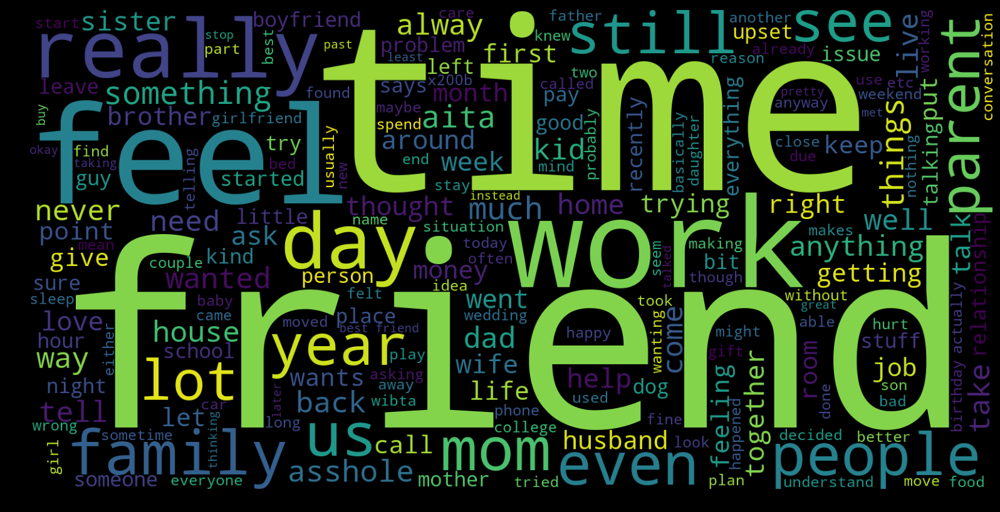

In [50]:
wordcloud = WordCloud(background_color="black",width=1600, height=800, stopwords=stopwords).generate(' '.join(nah_data.tolist()))
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wordcloud)

In [19]:
import numpy as np
np.savetxt(r'/Users/vaasay/Desktop/wordcloud/yta_data.txt', yta_data.values, fmt='%s')

In [21]:
nltk.download('genesis')

[nltk_data] Downloading package genesis to /Users/vaasay/nltk_data...
[nltk_data]   Unzipping corpora/genesis.zip.


True

In [30]:
yta_words = ' '.join([i for i in yta_data]).split()

In [32]:
from nltk.collocations import *
bigram_measures = nltk.collocations.BigramAssocMeasures()


# change this to read in your data
finder = BigramCollocationFinder.from_words((yta_words))

# only bigrams that appear 3+ times
finder.apply_freq_filter(3)


# return the 10 n-grams with the highest PMI
finder.nbest(bigram_measures.pmi, 10)

<bound method NgramAssocMeasures.pmi of <class 'nltk.metrics.association.BigramAssocMeasures'>>


[('burkina', 'faso'),
 ('dua', 'lipa'),
 ('feng', 'shui'),
 ('humpty', 'dumpty'),
 ('humtu', 'nunun'),
 ('hunky', 'dory'),
 ('junji', 'ito'),
 ('margot', 'robbie'),
 ('mont', 'blanc'),
 ('ncbi', 'nlm')]

In [35]:
for i in finder.score_ngrams(bigram_measures.pmi):
    print(i)

(('ncbi', 'nlm', 'nih'), 20.741070180898106)
(('nlm', 'nih', 'gov'), 17.571145179455794)
(('sclient', 'img', 'ei'), 17.28163856226081)
(('lnms', 'tbm', 'isch'), 17.12963546881576)
(('bih', 'biw', 'rlz'), 16.544672968094602)
(('biw', 'bih', '#imgrc'), 16.392669874649556)
(('mutant', 'ninja', 'turtles'), 15.788598550980693)
(('tbm', 'isch', 'ved'), 15.429195750674666)
(('dulce', 'de', 'leche'), 15.02835213297858)
(('tbm', 'isch', 'sa'), 15.014158251395823)
(('nc', 'ht', 'scontent'), 14.682176491844539)
(('ref', 'sr', 'crid'), 14.63254572411994)
(('www', 'ncbi', 'nlm'), 14.43121491831132)
(('adam', 'sander', 'shooping'), 13.73606949983974)
(('harvard', 'yale', 'princeton'), 13.285742960593545)
(('mayoclinic', 'org', 'diseases'), 13.236802914194737)
(('wikipedia', 'org', 'wiki'), 12.819394510453145)
(('source', 'lnms', 'tbm'), 12.606073512758748)
(('cul', 'de', 'sac'), 12.430789595477787)
(('teenage', 'mutant', 'ninja'), 12.116173209009196)
(('wp', 'content', 'uploads'), 12.004480337493469

In [34]:
bigram_measures = nltk.collocations.BigramAssocMeasures()


# change this to read in your data
finder = BigramCollocationFinder.from_words((yta_words))

# only bigrams that appear 3+ times
finder.apply_freq_filter(3)


# return the 10 n-grams with the highest PMI
finder.nbest(bigram_measures.pmi, 10)

[('ncbi', 'nlm', 'nih'),
 ('nlm', 'nih', 'gov'),
 ('sclient', 'img', 'ei'),
 ('lnms', 'tbm', 'isch'),
 ('bih', 'biw', 'rlz'),
 ('biw', 'bih', '#imgrc'),
 ('mutant', 'ninja', 'turtles'),
 ('tbm', 'isch', 'ved'),
 ('dulce', 'de', 'leche'),
 ('tbm', 'isch', 'sa')]